# Exploratory Data Analysis 

As Mentioned in the associated report, the goal of this project is to create a machine learning that can intake runners information and predict if they will get injured. Despite initial concerns that such a task would require extremely thorough data that was unavailable, a dataset was found that met these needs. The data was from a study with the University of Groningen, in the Netherlands, and followed a team of 74 semi-professional runners for just over 7 years. a link to the research article is bellow as well as a link to page on kaggle where it was downloaded from.


***Source of data:*** 

Research Article: https://pure.rug.nl/ws/portalfiles/portal/183763727/_15550273_International_Journal_of_Sports_Physiology_and_Performance_Injury_Prediction_in_Competitive_Runners_With_Machine_Learning.pdf


Kaggle Download: 
https://www.kaggle.com/datasets/shashwatwork/injury-prediction-for-competitive-runners?select=week_approach_maskedID_timeseries.csv

## Table of contents

1. [EDA of Dataset](#EDA-of-Dataset)
2. [Exploration of each column](#Exploration-of-each-column)
>- [Injury](#Injury)
>- [Features](#Features)
>- [Athlete ID](#Athlete-ID)
>- [Date](#Date)
>- [Repeating Features](#Repeating-Features)
>- [Nr.Sessions](#Nr.Sessions)
>-[Total Km's](#Total-Km's)
>-[km Z3-4](#km-Z3-4)
>-[km Z5-T1-T2](#km-Z5-T1-T2)
>-[km sprinting](#km-sprinting)
>-[Strength training](#Strength-training)
>-[Hours alternative](#Hours-alternative)
>-[Perceived Exertion](#Perceived-Exertion)
>-[Perceived Training Success](#Perceived-Training-Success)
>-[Perceived Recovery](#Perceived-Recovery)
3. [Comparing Feature Distributions](#Comparing-Feature-Distributions)
>- [Types of Running](#Types-of-Running)
>-[Perceived- Recovery, Exertion & Success](#Perceived--Recovery,-Exertion-&-Success)
4.[Investigating -0.01 in Percived- columns](#Investigating--0.01-in-Percived--columns)
5.[Replacing -0.01 with 0](#Replacing--0.01-with-0)
6.[Dropping extra columns?](#Dropping-extra-columns?)
7.[Conclusion](#Conclusion)



In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# EDA of Dataset

First we will load the data set and make some initial observations.

In [2]:
running_df=pd.read_csv('day_approach_maskedID_timeseries.csv')

In [3]:
running_df.shape

(42766, 73)

In [4]:
#Adjudting settings so we can see the entire set of columns/rows

pd.set_option('display.max_columns', None)

In [5]:
#Looking at the first 5 rows
running_df.head()


,nr. sessions,total km,km Z3-4,km Z5-T1-T2,km sprinting,strength training,hours alternative,perceived exertion,perceived trainingSuccess,perceived recovery,nr. sessions.1,total km.1,km Z3-4.1,km Z5-T1-T2.1,km sprinting.1,strength training.1,hours alternative.1,perceived exertion.1,perceived trainingSuccess.1,perceived recovery.1,nr. sessions.2,total km.2,km Z3-4.2,km Z5-T1-T2.2,km sprinting.2,strength training.2,hours alternative.2,perceived exertion.2,perceived trainingSuccess.2,perceived recovery.2,nr. sessions.3,total km.3,km Z3-4.3,km Z5-T1-T2.3,km sprinting.3,strength training.3,hours alternative.3,perceived exertion.3,perceived trainingSuccess.3,perceived recovery.3,nr. sessions.4,total km.4,km Z3-4.4,km Z5-T1-T2.4,km sprinting.4,strength training.4,hours alternative.4,perceived exertion.4,perceived trainingSuccess.4,perceived recovery.4,nr. sessions.5,total km.5,km Z3-4.5,km Z5-T1-T2.5,km sprinting.5,strength training.5,hours alternative.5,perceived exertion.5,perceived trainingSuccess.5,perceived recovery.5,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
0,1.0,5.8,0.0,0.6,1.2,0.0,0.00,0.11,0.00,0.18,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.0,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.10,0.00,0.15,0,0,0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.0,0.10,0.00,0.17,0,0,1
2,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.0,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0,0,2
3,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.10,0.00,0.17,0,0,3
4,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.10,0.00,0.17,1.0,17.6,7.2,0.0,0.0,0.0,0.0,0.11,0.00,0.17,0,0,4


In [7]:
running_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42766 entries, 0 to 42765
Data columns (total 73 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   nr. sessions                 42766 non-null  float64
 1   total km                     42766 non-null  float64
 2   km Z3-4                      42766 non-null  float64
 3   km Z5-T1-T2                  42766 non-null  float64
 4   km sprinting                 42766 non-null  float64
 5   strength training            42766 non-null  float64
 6   hours alternative            42766 non-null  float64
 7   perceived exertion           42766 non-null  float64
 8   perceived trainingSuccess    42766 non-null  float64
 9   perceived recovery           42766 non-null  float64
 10  nr. sessions.1               42766 non-null  float64
 11  total km.1                   42766 non-null  float64
 12  km Z3-4.1                    42766 non-null  float64
 13  km Z5-T1-T2.1   

In [8]:
running_df

,nr. sessions,total km,km Z3-4,km Z5-T1-T2,km sprinting,strength training,hours alternative,perceived exertion,perceived trainingSuccess,perceived recovery,nr. sessions.1,total km.1,km Z3-4.1,km Z5-T1-T2.1,km sprinting.1,strength training.1,hours alternative.1,perceived exertion.1,perceived trainingSuccess.1,perceived recovery.1,nr. sessions.2,total km.2,km Z3-4.2,km Z5-T1-T2.2,km sprinting.2,strength training.2,hours alternative.2,perceived exertion.2,perceived trainingSuccess.2,perceived recovery.2,nr. sessions.3,total km.3,km Z3-4.3,km Z5-T1-T2.3,km sprinting.3,strength training.3,hours alternative.3,perceived exertion.3,perceived trainingSuccess.3,perceived recovery.3,nr. sessions.4,total km.4,km Z3-4.4,km Z5-T1-T2.4,km sprinting.4,strength training.4,hours alternative.4,perceived exertion.4,perceived trainingSuccess.4,perceived recovery.4,nr. sessions.5,total km.5,km Z3-4.5,km Z5-T1-T2.5,km sprinting.5,strength training.5,hours alternative.5,perceived exertion.5,perceived trainingSuccess.5,perceived recovery.5,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
0,1.0,5.8,0.0,0.6,1.2,0.0,0.00,0.11,0.00,0.18,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.0,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.10,0.00,0.15,0,0,0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.0,0.10,0.00,0.17,0,0,1
2,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.0,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0,0,2
3,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.10,0.00,0.17,0,0,3
4,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.00,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.00,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.00,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.00,0.10,0.00,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.10,0.00,0.17,1.0,17.6,7.2,0.0,0.0,0.0,0.0,0.11,0.00,0.17,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42761,1.0,16.0,0.0,0.0,0.0,0.0,0.00,0.54,0.22,0.30,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,19.0,0.0,0.0,0.0,0.0,0.00,0.91,0.72,0.41,1.0,8.0,0.0,0.0,0.0,0.0,0.00,0.08,0.93,0.24,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,16.5,0.0,0.0,0.0,0.0,0.0,0.15,0.75,0.32,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,71,1,2143
42762,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,5.8,0.0,0.0,0.0,0.0,0.00,0.45,0.46,0.06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,71,1,2286
42763,1.0,10.0,0.0,0.0,0.0,0.0,0.00,0.94,0.88,0.11,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.00,-0.01,-0.01,-0.01,1.0,16.0,0.0,0.0,0.0,0.0,0.00,0.85,0.37,0.26,0.0

In [9]:
#Inspecting the last 5 rows
running_df.tail()


,nr. sessions,total km,km Z3-4,km Z5-T1-T2,km sprinting,strength training,hours alternative,perceived exertion,perceived trainingSuccess,perceived recovery,nr. sessions.1,total km.1,km Z3-4.1,km Z5-T1-T2.1,km sprinting.1,strength training.1,hours alternative.1,perceived exertion.1,perceived trainingSuccess.1,perceived recovery.1,nr. sessions.2,total km.2,km Z3-4.2,km Z5-T1-T2.2,km sprinting.2,strength training.2,hours alternative.2,perceived exertion.2,perceived trainingSuccess.2,perceived recovery.2,nr. sessions.3,total km.3,km Z3-4.3,km Z5-T1-T2.3,km sprinting.3,strength training.3,hours alternative.3,perceived exertion.3,perceived trainingSuccess.3,perceived recovery.3,nr. sessions.4,total km.4,km Z3-4.4,km Z5-T1-T2.4,km sprinting.4,strength training.4,hours alternative.4,perceived exertion.4,perceived trainingSuccess.4,perceived recovery.4,nr. sessions.5,total km.5,km Z3-4.5,km Z5-T1-T2.5,km sprinting.5,strength training.5,hours alternative.5,perceived exertion.5,perceived trainingSuccess.5,perceived recovery.5,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
42761,1.0,16.0,0.0,0.0,0.0,0.0,0.0,0.54,0.22,0.30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,19.0,0.0,0.0,0.0,0.0,0.0,0.91,0.72,0.41,1.0,8.0,0.0,0.0,0.0,0.0,0.0,0.08,0.93,0.24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,16.5,0.0,0.0,0.0,0.0,0.0,0.15,0.75,0.32,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,71,1,2143
42762,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,5.8,0.0,0.0,0.0,0.0,0.0,0.45,0.46,0.06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,71,1,2286
42763,1.0,10.0,0.0,0.0,0.0,0.0,0.0,0.94,0.88,0.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,16.0,0.0,0.0,0.0,0.0,0.0,0.85,0.37,0.26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,12.3,0.0,0.0,0.0,0.0,0.0,0.44,0.82,0.30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,71,1,2483
42764,1.0,15.1,0.0,0.0,0.0,0.0,0.0,0.87,0.86,0.20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,13.4,0.0,0.0,0.0,0.0,0.0,0.49,0.87,0.14,1.0,14.9,0.0,0.0,0.0,0.0,0.0,0.73,0.81,0.19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,12.5,0.0,0.0,0.0,0.0,0.0,0.35,0.82,0.19,1.0,11.1,0.0,0.0,0.0,0.0,0.0,0.79,0.80,0.11,71,1,2647
42765,1.0,12.2,0.0,0.0,0.0,0.0,0.0,0.96,0.95,0.20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,11.1,0.0,0.0,0.0,0.0,0.0,0.36,0.76,0.37,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,10.0,0.0,0.0,0.0,0.0,0.0,1.00,0.66,0.57,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.01,-0.01,-0.01,1.0,11.7,0.0,0.0,0.0,0.0,0.0,0.51,0.83,0.15,71,1,2673


In [10]:
running_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42766 entries, 0 to 42765
Data columns (total 73 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   nr. sessions                 42766 non-null  float64
 1   total km                     42766 non-null  float64
 2   km Z3-4                      42766 non-null  float64
 3   km Z5-T1-T2                  42766 non-null  float64
 4   km sprinting                 42766 non-null  float64
 5   strength training            42766 non-null  float64
 6   hours alternative            42766 non-null  float64
 7   perceived exertion           42766 non-null  float64
 8   perceived trainingSuccess    42766 non-null  float64
 9   perceived recovery           42766 non-null  float64
 10  nr. sessions.1               42766 non-null  float64
 11  total km.1                   42766 non-null  float64
 12  km Z3-4.1                    42766 non-null  float64
 13  km Z5-T1-T2.1   

In [11]:
running_df.describe()

,nr. sessions,total km,km Z3-4,km Z5-T1-T2,km sprinting,strength training,hours alternative,perceived exertion,perceived trainingSuccess,perceived recovery,nr. sessions.1,total km.1,km Z3-4.1,km Z5-T1-T2.1,km sprinting.1,strength training.1,hours alternative.1,perceived exertion.1,perceived trainingSuccess.1,perceived recovery.1,nr. sessions.2,total km.2,km Z3-4.2,km Z5-T1-T2.2,km sprinting.2,strength training.2,hours alternative.2,perceived exertion.2,perceived trainingSuccess.2,perceived recovery.2,nr. sessions.3,total km.3,km Z3-4.3,km Z5-T1-T2.3,km sprinting.3,strength training.3,hours alternative.3,perceived exertion.3,perceived trainingSuccess.3,perceived recovery.3,nr. sessions.4,total km.4,km Z3-4.4,km Z5-T1-T2.4,km sprinting.4,strength training.4,hours alternative.4,perceived exertion.4,perceived trainingSuccess.4,perceived recovery.4,nr. sessions.5,total km.5,km Z3-4.5,km Z5-T1-T2.5,km sprinting.5,strength training.5,hours alternative.5,perceived exertion.5,perceived trainingSuccess.5,perceived recovery.5,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
count,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000
mean,0.829561,7.038187,0.691381,0.579930,0.073016,0.116237,0.163492,0.247788,0.349802,0.195898,0.829000,7.024199,0.689436,0.574926,0.072614,0.117126,0.164331,0.247228,0.349327,0.195780,0.829561,7.039143,0.695195,0.578438,0.073135,0.116518,0.163359,0.247726,0.349382,0.196104,0.829280,7.039936,0.692611,0.578181,0.072693,0.116307,0.162977,0.247664,0.349609,0.196164,0.829865,7.042934,0.695447,0.577788,0.072167,0.116214,0.162675,0.247642,0.349797,0.196250,0.828766,7.054684,0.697388,0.580073,0.072303,0.115886,0.161330,0.247697,0.349669,0.196298,0.828813,7.051319,0.695031,0.580347,0.072595,0.116120,0.162308,0.247550,0.349503,0.196224,34.550858,0.013632,1228.039892
std,0.580696,7.473216,2.317657,1.811938,0.483480,0.326010,0.549664,0.257262,0.368300,0.190321,0.581215,7.473041,2.310966,1.805558,0.484186,0.327197,0.552471,0.256781,0.368236,0.190313,0.580736,7.470759,2.328649,1.808320,0.485633,0.326699,0.550724,0.257149,0.368063,0.190505,0.580533,7.464805,2.315000,1.810760,0.481981,0.326380,0.548887,0.257077,0.368157,0.190568,0.580321,7.461837,2.324751,1.807505,0.479745,0.326270,0.546884,0.256785,0.368123,0.190499,0.579696,7.470514,2.327571,1.811543,0.487074,0.325741,0.544333,0.256950,0.368109,0.190694,0.579951,7.470174,2.323844,1.814538,0.483691,0.326016,0.554031,0.256718,0.368042,0.190568,19.050033,0.115960,807.021168
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000

#### Initial Observations
- The data set has an interesting lay out, with 10 features that repeat 7 times, representing each feature measure the 7 days leading up to an injury/non-injury. There are 3 more features (`Date`, `Athlete ID` and `injury`), bringing the total amount of columns to 73.
- The repeating-features have extremely similar values on the (count, mean, std, min-max)
- Some columns are heavily skewed; the max is typically far above the 75th eprcentile, ( `km Z3-4`, `hours alternative`, `km Z5-T1-T2`, `km sprinting`, (and their associated repeated columns), stand out in particular).	
   - possible reason for this could be that some atheltes take days off wile others run varying amounts, so it is more likely to see 0 values than any one number. more likely to find multiple 0 values 
- `Date`:
    - from the head and tail, we can see that date is infact a count, relative to each atheltes number of days training, not an actual date column (i.e. calendar dates).
    - Max date (2673) is the largest date entered for an athelte, meaning they have record of an atheltes traiing for just over 7 years, how ever this would include lulls in training, (noted from the df.describe)	
- strength training is a count of the number of strength sessions per day

Next we will check for null values and duplicates.

In [12]:
running_df.isna().any().sum()

0

In [13]:
running_df.isna().sum()

nr. sessions                   0
total km                       0
km Z3-4                        0
km Z5-T1-T2                    0
km sprinting                   0
                              ..
perceived trainingSuccess.6    0
perceived recovery.6           0
Athlete ID                     0
injury                         0
Date                           0
Length: 73, dtype: int64

In [14]:
running_df.duplicated().sum()

0

There appears to be no null values nor are there noted in the entire data set. Expected considering it was collected from a semi-professional running club, for a study of this nature.

# Exploration of each column
In this section we will look a bit more deeply at each column as well as compare them to our target variable (injury).

In [15]:
#using the last 13 columsn for reference as it shows the repeated features and the last 3 unique features.
running_df.nunique().tail(13)

nr. sessions.6                    3
total km.6                      384
km Z3-4.6                       175
km Z5-T1-T2.6                   134
km sprinting.6                   79
strength training.6               3
hours alternative.6             208
perceived exertion.6            102
perceived trainingSuccess.6     102
perceived recovery.6            100
Athlete ID                       74
injury                            2
Date                           2614
dtype: int64

In [16]:
running_df['Date']

0           0
1           1
2           2
3           3
4           4
         ... 
42761    2143
42762    2286
42763    2483
42764    2647
42765    2673
Name: Date, Length: 42766, dtype: int64

Will potentially use one day's set of features to go through the data (i.e. speciffically look at `total km.6` rather than eachh `total km.x`.

## Injury
First we will look into our target variable- Injury.

In [17]:
#break down of column
running_df['injury'].value_counts()

0    42183
1      583
Name: injury, dtype: int64

In [18]:
#break down of column (percentage of inj occurence)
running_df['injury'].value_counts(normalize= True)

0    0.986368
1    0.013632
Name: injury, dtype: float64

The two cells above show the data is heavily imbalanced with less than 2% of the data poiunts showing an injury.

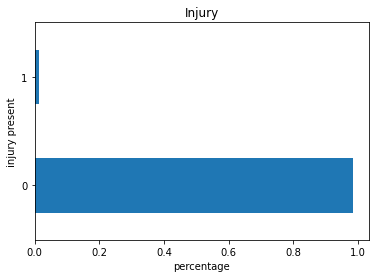

In [19]:
#plotting injury distribution
running_df['injury'].value_counts(normalize= True).plot(kind= 'barh', title= "Injury")
plt.ylabel('injury present')
plt.xlabel ('percentage')
plt.show()

The graph above further illustrates the imbalance. This will have to be adjsuted for when tuning our models.


## Features
Now we will explore the features (Athlete ID, Date, and one column from each repeating feature)

In [20]:
#creating a data set to manipulate
indep_features_sample= running_df[['nr. sessions','total km', 'km Z3-4', 'km Z5-T1-T2',\
                                  'km sprinting','strength training', 'hours alternative', 'perceived exertion',\
                                  'perceived trainingSuccess', 'perceived recovery', 'Athlete ID', 'Date', 'injury']]
                                  


Will create a pair plot and heat map to look at the distribution of each feature and see interactions between 2.

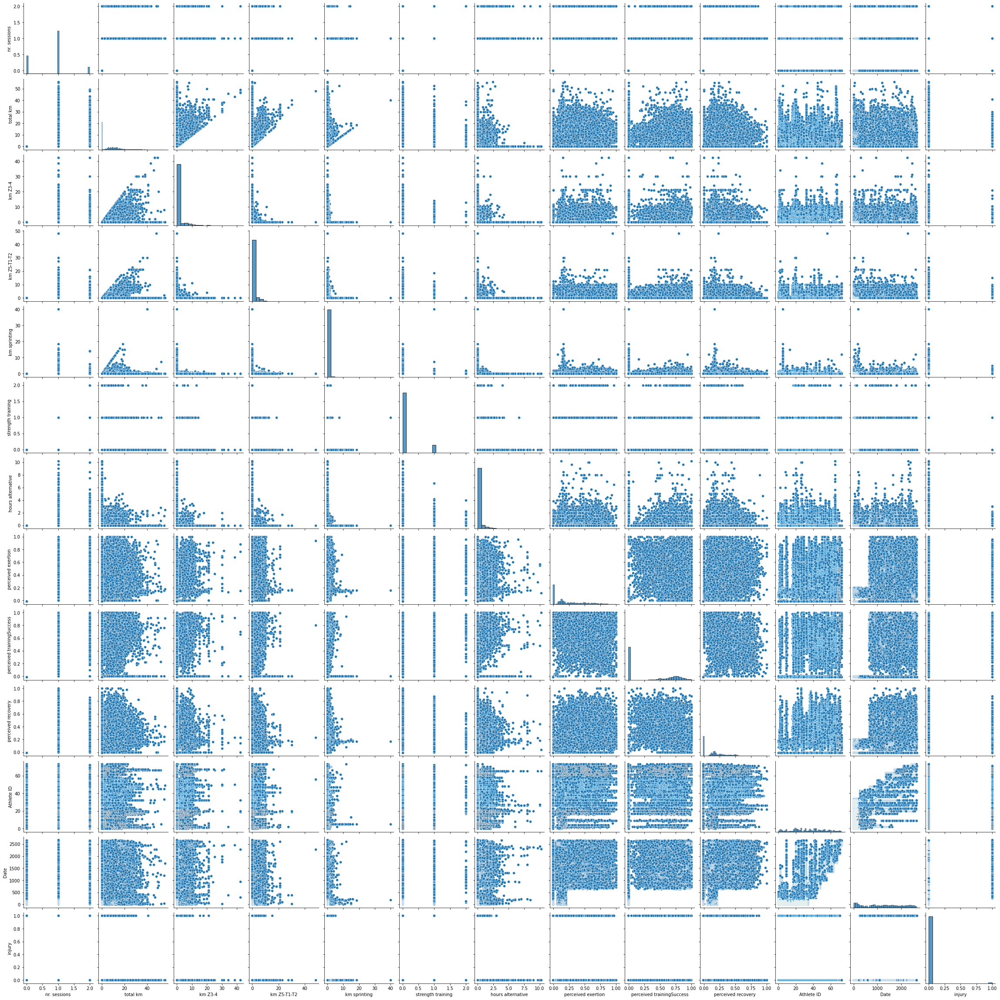

In [21]:
#pairplot to see distributions of each fature as well as interactions betwen 2
sns.pairplot(indep_features_sample)

observations:
- expected correlations between `total km` and several feeatures
>- each of the 3 typs of running.
>- recovery goes down as km goes up
>- there are more occurences of strength and alternative training, when total kms ran is lower
- there is an outlier in the `km sprinting` feature
- 0 appears to be the most common value in many of the features

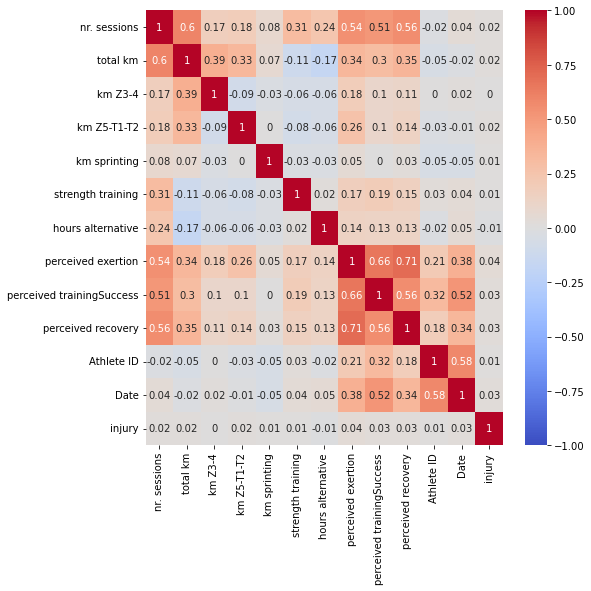

In [22]:
#heat map to look for initial correlations
plt.figure(figsize=(8,8))
sns.heatmap(indep_features_sample.corr().round(2), vmin=-1, vmax=1, annot=True, cmap="coolwarm")
plt.show()

### Observations from heat map:
- can see high correlations between, `percieved exertion` and `perceived recovery` (.71)
- percieved recovery and training success(.66)
- weird corr between `ath id`and `date`
- also nr. sessions hihgly correlated with `total km` (obvs), and all the pervived columns ('`exertion`, `recovery`, `success`)
- date also has pos correlation w training success
- 

#### attempts at creating EDA function
For the remaining columns we will create a function to help with preliminary analysis of each column

In [23]:
#creating a function to reuse on each column we look through
def column_inspector(column_name):
    #nunique
    print(f'there are {running_df[column_name].nunique()} unique values')
    
    # value count
    print(running_df[column_name].value_counts(normalize=True))
    
    # plot
    plt.figure()
    running_df[column_name].value_counts(normalize=True).plot(kind="bar", title=column_name)
    plt.show()
    
    # crosstab with registered
    print(pd.crosstab(running_df[column_name], running_df['injury']))

For the EDA only of the sections of repeated features (i.e. all the **.1** features), as they all  have a similar distribution, (shown bellow).

## Athlete ID

In [24]:
#see unique values
running_df['Athlete ID'].nunique()


74

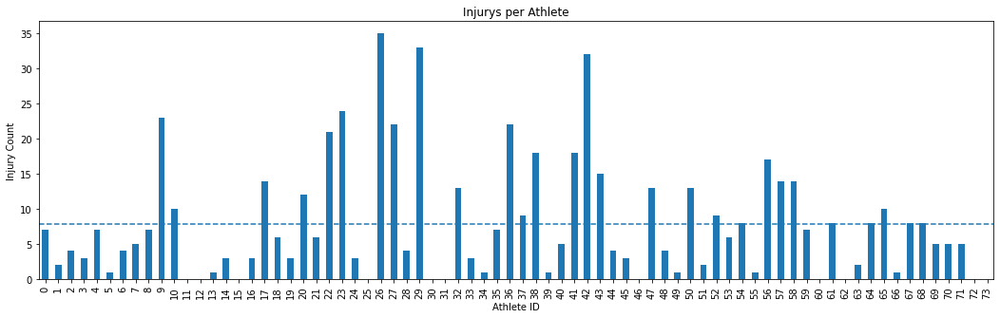

In [25]:
# Compare to target column (injury)
athlete_inj= running_df.groupby('Athlete ID').sum()['injury']


#graph
plt.figure(figsize=[18,5])
athlete_inj.plot(kind= 'bar')
plt.title('Injurys per Athlete' )
plt.ylabel('Injury Count')
plt.axhline(athlete_inj.mean(), linestyle = '--') #why was this wrong??
plt.show()


In [26]:
ath_inj_df= pd.DataFrame(data=athlete_inj)

ath_inj_df.describe()

,injury
count,74.000000
mean,7.878378
std,8.261070
min,0.000000
25%,2.000000
50%,5.000000
75%,11.500000
max,35.000000


##### Athlete ID observations:
- there are 74 athletes
- the mean number of injury days is 7.8 (meaning athlete was deemed injured and likely did not return the next day).
- the bar graph shows that there were some out liers far above, i.e.e athlete ID-26 or ID-29 with over 30 injuries.
- also ID's 5 or 6 with 0 injuries reported.


# Date


In [27]:
#by seeing unique values this will also show us max number of days 
running_df['Date'].nunique()

2614

In [28]:
running_df['Date'].describe()

count    42766.000000
mean      1228.039892
std        807.021168
min          0.000000
25%        436.000000
50%       1256.000000
75%       1913.000000
max       2673.000000
Name: Date, dtype: float64

In [29]:
#plotting the distribution of dates
fig= px.histogram(running_df, x='Date',nbins=100 )
fig.update_layout( 
    title="Distribution of Dates"
)
fig.write_html("dates.html")
fig.show()

### Note regarding continuous Date
After seeing the dip in recorded dates at around 600, and looking back at the Dataframe tail, saw that there are date inputs for atheltes that skip over days (i.e. 2648, next input is 2653). It was also noted that these are also inputs where the athelte is injured. Will go forward with the assumption/understanding that that when an athelte is injured they do not run and those dyas are skipped over, but the date-count keeps running outside of what is shown.

In [30]:
#making a data set to compare the injury compared to date
date_inj=(pd.crosstab(running_df['Date'], running_df['injury']))
Date_inj= pd.DataFrame(data=date_inj)
Date_inj.T #sanity check

Date,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,598,603,605,606,610,640,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023,1024,1025,1026,1027,1028,1029,1030,1031,1032,1033,1034,1035,1036,1037,1038,1039,1040,1041,1042,1043,1044,1045,1046,1047,1048,1049,1050,1051,1052,1053

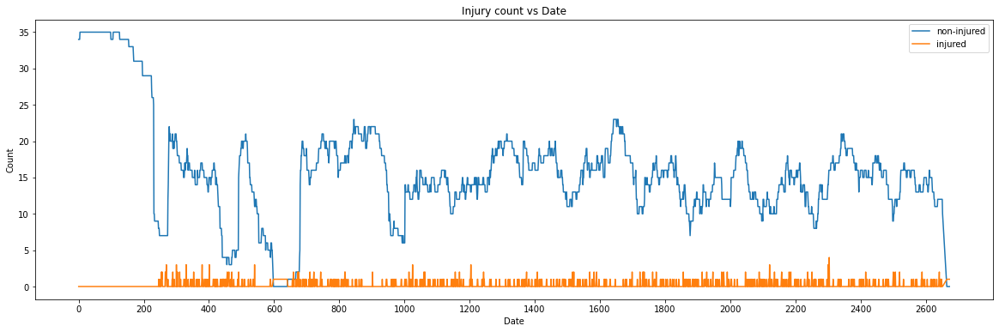

In [31]:
#plotting injury vs Date
plt.figure(figsize=(20,6))
plt.plot(Date_inj)
plt.title('Injury count vs Date')
plt.xlabel('Date')
plt.ylabel('Count')
plt.legend(['non-injured','injured'])
plt.xticks(np.arange(0, 2700, step=200))
plt.show()

##### Take away point from Date feature:
- the largest date recorded was 2614, meaning that we have records of athletes training for up over 7 years
- our **Injury count vs Date** graph inadvertedly shows athlete count that day as well;
> - graph doesnt necessarily show trends in athlete seasons, ie break evrey 100 hundred days
> - we can see that basically at any point we only ever see a max of 35 athletes training at once
>- at 600days into training most atheletes were not competing. Potential a time whwere many atheltes were injured or had reason to be away from trianing?
>- many atheltes make it through first 200 days then avg 20 atheltes checking in.

# Repeating Features
Bellow we will continue our feature exploration looking into the 10 repeated features (listed bellow). However considering that the values of each day shift through the features (.6 down), and that it was observed eariler that the columns of the same feature type had a extremely similar values shown in the df.describe, we will only investigate one column from each and use that as representation for the rest. In our case we will be working with the first 10 columns (which can be seen bellow).

In [32]:
running_df.info(10)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42766 entries, 0 to 42765
Data columns (total 73 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   nr. sessions                 42766 non-null  float64
 1   total km                     42766 non-null  float64
 2   km Z3-4                      42766 non-null  float64
 3   km Z5-T1-T2                  42766 non-null  float64
 4   km sprinting                 42766 non-null  float64
 5   strength training            42766 non-null  float64
 6   hours alternative            42766 non-null  float64
 7   perceived exertion           42766 non-null  float64
 8   perceived trainingSuccess    42766 non-null  float64
 9   perceived recovery           42766 non-null  float64
 10  nr. sessions.1               42766 non-null  float64
 11  total km.1                   42766 non-null  float64
 12  km Z3-4.1                    42766 non-null  float64
 13  km Z5-T1-T2.1   

To speed up the inspection of these columns we will create a function that shows the columnsnormalized value counts (percentage break down of elements), and a cross tab between the feature and injury.Would have included the generation of a histogram for each graph but that will be done seperately so that we can adjust the binsize depending on the feature. Graphs comparing each feature to the target variable will also be added.

In [33]:
# creating funciton
def column_inspector(col_name):
    
    # value count--> percentage breakdown
    print(running_df[col_name].value_counts(normalize=True))
    
    #describe
    print(running_df[col_name].describe())
    
    # crosstab with registered
    print(pd.crosstab(running_df[col_name], running_df['injury']))
    

## Nr.Sessions


In [34]:
column_inspector('nr. sessions')


1.0    0.633751
0.0    0.268344
2.0    0.097905
Name: nr. sessions, dtype: float64
count    42766.000000
mean         0.829561
std          0.580696
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          2.000000
Name: nr. sessions, dtype: float64
injury            0    1
nr. sessions            
0.0           11376  100
1.0           26690  413
2.0            4117   70


In [35]:
  #plotting. distribution
fig= px.histogram(running_df, x='nr. sessions', nbins=50 )   
fig.update_layout( 
title="Distribution of nr.sessions"
)
fig.show()

#### Nr.Sessions observations
- This column shows the number of execise sessions the runner had that day
- We can see that 63% of athletes are doing only 1 session with, 26% doing nothing, and 9.7% doing 2
- would be interesting to see the amount of injuries for these athletes doing two- do the added exercise sessions increase fatigue?


## Total Km's

In [36]:
column_inspector('total km')

0.0     0.404691
10.0    0.021021
13.0    0.019057
12.0    0.019010
6.0     0.018660
          ...   
45.8    0.000023
27.6    0.000023
46.6    0.000023
45.9    0.000023
38.1    0.000023
Name: total km, Length: 384, dtype: float64
count    42766.000000
mean         7.038187
std          7.473216
min          0.000000
25%          0.000000
50%          6.000000
75%         12.000000
max         55.900000
Name: total km, dtype: float64
injury        0    1
total km            
0.0       17137  170
0.1          14    0
0.2           1    1
0.3           2    0
0.4           5    0
...         ...  ...
51.0          1    0
52.0          2    0
52.5          1    0
55.0          2    0
55.9          1    0

[384 rows x 2 columns]


In [37]:
fig= px.histogram(running_df, x='total km', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of total km (.0)"
)
fig.write_html("totalkm.html")

fig.show()

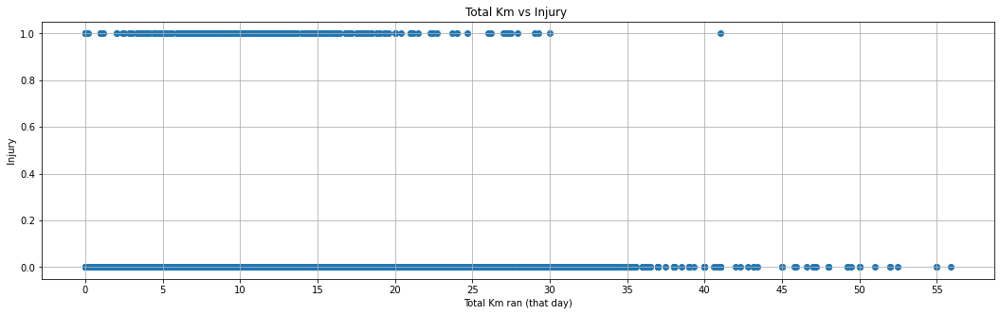

In [38]:
#comparing feature to inj
plt.figure(figsize=[18,5])
plt.scatter(running_df['total km'], running_df['injury'])
plt.title('Total Km vs Injury ')
plt.xlabel('Total Km ran (that day)')
plt.ylabel('Injury')
plt.xticks(np.arange(0,60, step=5))
plt.grid()
plt.show()


##### observations on Total km:
- shows the total number of km ran that day by an athelte
- 40% of athletes doing 0km
- the next most common total distance per day was 10km
- mean distance per day is 7km
- Would be interesting to see if the 0's we a result of injury or not
- in the `Total km vs Inury`graph we can see that days with more total km are less associated with subsequent injury which may seem surprising but could also be a result of atheltes being aware of of fulling good or bad and adding mileage accordingly


## km Z3-4 

In [39]:
column_inspector('km Z3-4')

0.0     0.890053
6.0     0.011972
8.0     0.007389
4.0     0.006664
5.0     0.006524
          ...   
20.5    0.000023
12.9    0.000023
19.5    0.000023
18.5    0.000023
15.4    0.000023
Name: km Z3-4, Length: 174, dtype: float64
count    42766.000000
mean         0.691381
std          2.317657
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         42.200000
Name: km Z3-4, dtype: float64
injury       0    1
km Z3-4            
0.0      37544  520
0.1          2    1
0.2          2    0
0.3          3    0
0.4          9    0
...        ...  ...
30.0         9    0
31.1         1    0
34.0         1    0
38.5         1    0
42.2         3    0

[174 rows x 2 columns]


In [40]:
fig= px.histogram(running_df, x='km Z3-4', nbins=50)
fig.update_layout(title="Distribution of km Z3-4")
fig.show()

In [41]:
#comparing feature to inj
fig = px.scatter(running_df, x="km Z3-4", y="injury")   
fig.update_layout( title="Injury vs km Z3-4")
fig.show()

##### Observations from  `km Z3-4`:
- this column shows kilmoeters ran within a particular effrot (Z referes to a particular heart rate zone, with Z1 being resting and Z5 being near max heart rate).
- nearly 90% of the atheletes have run 0km at this efffort, how ever 6km at said effort is the next most common.
- little to no injury seen inatheltes with greater km ran in this range

## km Z5-T1-T2

In [42]:
column_inspector('km Z5-T1-T2')

0.0     0.866787
6.0     0.015339
3.0     0.011130
4.0     0.009283
5.0     0.007296
          ...   
10.6    0.000023
19.0    0.000023
14.5    0.000023
10.8    0.000023
10.7    0.000023
Name: km Z5-T1-T2, Length: 134, dtype: float64
count    42766.000000
mean         0.579930
std          1.811938
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         48.000000
Name: km Z5-T1-T2, dtype: float64
injury           0    1
km Z5-T1-T2            
0.0          36603  466
0.1              3    0
0.2              8    0
0.3             12    0
0.4             29    1
...            ...  ...
21.1            15    0
22.8             1    0
27.5             1    0
30.0             2    0
48.0             1    0

[134 rows x 2 columns]


In [43]:
fig= px.histogram(running_df, x='km Z5-T1-T2', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of km Z5-T1-T2"
)
fig.show()

In [44]:
#comparing feature to inj
fig = px.scatter(running_df, x="km Z5-T1-T2", y="injury")   
fig.update_layout( title="Injury vs km Z5-T1-T2")
fig.show()

##### Notes of `km Z5-T1-T2`:
- this column shows kilmoeters ran with greater effort (higher heart rate zone), and T1-2 represent doing track intevals(very high effort)
- similar to the last column we can see that 0 km at this effrot accounts for nearly 90% (in this case 86) of data points
- the mean distance ran per day at this effort is even lower than the pervious effort range, these features are heavily affected by all the 0 values.
- Again see few injuries at greater distances rna in this effort range

## km sprinting

In [45]:
column_inspector('km sprinting')

0.0     0.924590
0.3     0.011762
0.5     0.009330
1.0     0.009213
0.4     0.009166
          ...   
13.8    0.000023
9.7     0.000023
4.8     0.000023
9.6     0.000023
12.0    0.000023
Name: km sprinting, Length: 78, dtype: float64
count    42766.000000
mean         0.073016
std          0.483480
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         40.000000
Name: km sprinting, dtype: float64
injury            0    1
km sprinting            
0.0           39022  519
0.1              28    0
0.2             218    2
0.3             498    5
0.4             387    5
...             ...  ...
14.3              1    0
15.0              2    0
15.9              2    0
18.6              1    0
40.0              1    0

[78 rows x 2 columns]


In [46]:
fig= px.histogram(running_df, x='km sprinting', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of km sprinting"
)
fig.show()

In [47]:
#comparing feature to inj
fig = px.scatter(running_df, x="km sprinting", y="injury")   
fig.update_layout( title="km sprinting vs injury")
fig.show()

##### Observations from `km sprinting`:
- 92% of inputs had this as 0
- mean was the lowest of all running features so far (70m per day)


## Strength training

In [48]:
column_inspector('strength training')

0.0    0.885540
1.0    0.112683
2.0    0.001777
Name: strength training, dtype: float64
count    42766.000000
mean         0.116237
std          0.326010
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: strength training, dtype: float64
injury                 0    1
strength training            
0.0                37365  506
1.0                 4742   77
2.0                   76    0


In [49]:
fig= px.histogram(running_df, x='strength training', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of strength training"
)
fig.show()

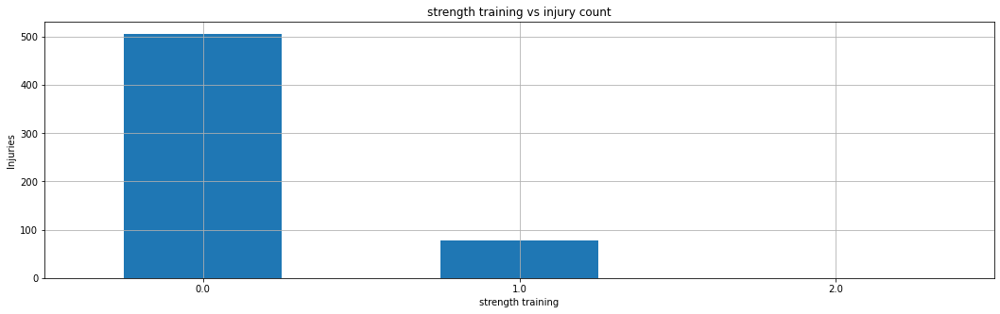

In [50]:
# Compare to target column (injury)
exertion_inj= running_df.groupby('strength training').sum()['injury']

#graph
plt.figure(figsize=[18,5])
exertion_inj.plot(kind= 'bar')
plt.title('strength training vs injury count')
plt.ylabel('Injuries')
plt.xticks(rotation=0)
plt.grid()
plt.show()

##### Observations from `strength training`:
- no injury reported in the category with 2 strength training sessions
- 88% of the data points have 0 as the number of strength trainng sessions
- 0 strength training also had the most injuries (just over 500)

## Hours alternative

In [51]:
column_inspector('hours alternative')

0.00    0.876888
1.00    0.023126
1.50    0.011013
0.75    0.010359
2.00    0.007974
          ...   
5.83    0.000023
1.18    0.000023
9.00    0.000023
0.82    0.000023
2.57    0.000023
Name: hours alternative, Length: 208, dtype: float64
count    42766.000000
mean         0.163492
std          0.549664
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         10.220000
Name: hours alternative, dtype: float64
injury                 0    1
hours alternative            
0.00               36978  523
0.02                  54    0
0.03                   7    0
0.05                   4    0
0.07                   3    0
...                  ...  ...
8.50                   1    0
9.00                   1    0
9.67                   1    0
10.00                  2    0
10.22                  1    0

[208 rows x 2 columns]


In [52]:
fig= px.histogram(running_df, x='hours alternative', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of 'hours alternative' "
)
fig.show()

In [53]:
#comparing feature to inj
fig = px.scatter(running_df, x="hours alternative", y="injury")   
fig.update_layout( title="hours alternative vs Injury")
fig.show()

##### Observations from `hours alternative`:
- injuries seen more commonly wiht fewer hours of alternative exercise; could a lack fo cross trianing be leadingi to injury?
- Again 0 made up 88% of the values for this feature

### Percieved Exertion

In [54]:
column_inspector('perceived exertion')

-0.01    0.268344
 0.14    0.028925
 0.15    0.028036
 0.11    0.027124
 0.13    0.025885
           ...   
 0.02    0.000655
 0.01    0.000538
 0.97    0.000444
 0.99    0.000327
 0.98    0.000304
Name: perceived exertion, Length: 102, dtype: float64
count    42766.000000
mean         0.247788
std          0.257262
min         -0.010000
25%         -0.010000
50%          0.160000
75%          0.440000
max          1.000000
Name: perceived exertion, dtype: float64
injury                  0    1
perceived exertion            
-0.01               11376  100
 0.00                1025   14
 0.01                  23    0
 0.02                  27    1
 0.03                  39    1
...                   ...  ...
 0.96                  36    2
 0.97                  19    0
 0.98                  13    0
 0.99                  14    0
 1.00                  44    0

[102 rows x 2 columns]


In [55]:
fig= px.histogram(running_df, x='perceived exertion', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of 'perceived exertion' "
)
fig.show()

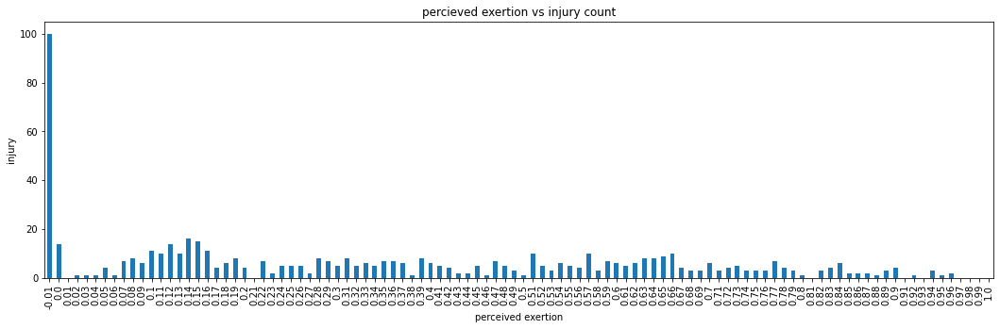

In [56]:
# Compare to target column (injury)
exertion_inj= running_df.groupby('perceived exertion').sum()['injury']


#graph
plt.figure(figsize=[18,5])
exertion_inj.plot(kind= 'bar')
plt.title('percieved exertion vs injury count')
plt.ylabel('injury')
plt.show()


##### Observations from `perceived exertion`:
- 0 appears to be the most associated with injury, how ever it is also simply the most prominent value in this feature
- **NOTE** we can see that a large portion of the values are -0.01, which doesnt make sense as this is supposed to be a 0-1 scale

### Percieved Training Success

In [57]:
column_inspector('perceived trainingSuccess')

-0.01    0.268344
 0.00    0.219637
 0.74    0.016625
 0.76    0.015994
 0.80    0.015573
           ...   
 0.05    0.000234
 0.07    0.000210
 0.03    0.000210
 0.06    0.000187
 0.01    0.000047
Name: perceived trainingSuccess, Length: 102, dtype: float64
count    42766.000000
mean         0.349802
std          0.368300
min         -0.010000
25%         -0.010000
50%          0.260000
75%          0.720000
max          1.000000
Name: perceived trainingSuccess, dtype: float64
injury                         0    1
perceived trainingSuccess            
-0.01                      11376  100
 0.00                       9301   92
 0.01                          2    0
 0.02                         13    0
 0.03                          9    0
...                          ...  ...
 0.96                        167    3
 0.97                        126    7
 0.98                        147    1
 0.99                         78    1
 1.00                        197    3

[102 rows x 2 columns]

In [58]:
fig= px.histogram(running_df, x='perceived trainingSuccess', histnorm= 'percent', nbins=50)
fig.update_layout( 
    title="Distribution of 'perceived trainingSuccess' "
)
fig.show()

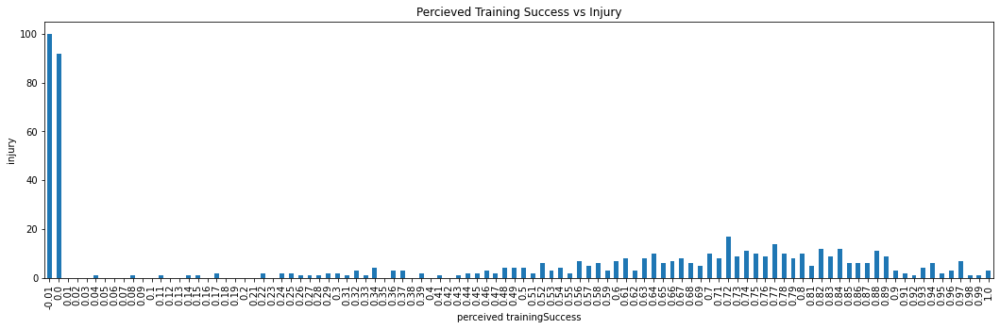

In [59]:
# Compare to target column (injury)
trainingSuccess_inj= running_df.groupby('perceived trainingSuccess').sum()['injury']


#graph
plt.figure(figsize=[18,5])
trainingSuccess_inj.plot(kind= 'bar')
plt.title('Percieved Training Success vs Injury')
plt.ylabel('injury')
plt.show()


##### Observations from `perceived training success`:
- again we see -0.01 making up the majority of values*
- ingoring the 0 and -0.01 values, we can see the just bellow 0.8 values appear to be normalizing

## Perceived Recovery

In [60]:
column_inspector('perceived recovery')

-0.01    0.268344
 0.16    0.037577
 0.18    0.037413
 0.17    0.033134
 0.14    0.032666
           ...   
 0.94    0.000070
 0.98    0.000047
 0.95    0.000047
 0.93    0.000047
 0.97    0.000023
Name: perceived recovery, Length: 100, dtype: float64
count    42766.000000
mean         0.195898
std          0.190321
min         -0.010000
25%         -0.010000
50%          0.160000
75%          0.300000
max          1.000000
Name: perceived recovery, dtype: float64
injury                  0    1
perceived recovery            
-0.01               11376  100
 0.00                1109   13
 0.01                  18    1
 0.02                  25    0
 0.03                  20    0
...                   ...  ...
 0.94                   3    0
 0.95                   2    0
 0.97                   1    0
 0.98                   2    0
 1.00                   6    0

[100 rows x 2 columns]


In [61]:
fig= px.histogram(running_df, x='perceived recovery', histnorm= 'percent', nbins=10)
fig.update_layout( 
    title="Distribution of 'perceived recovery' "
)
fig.show()

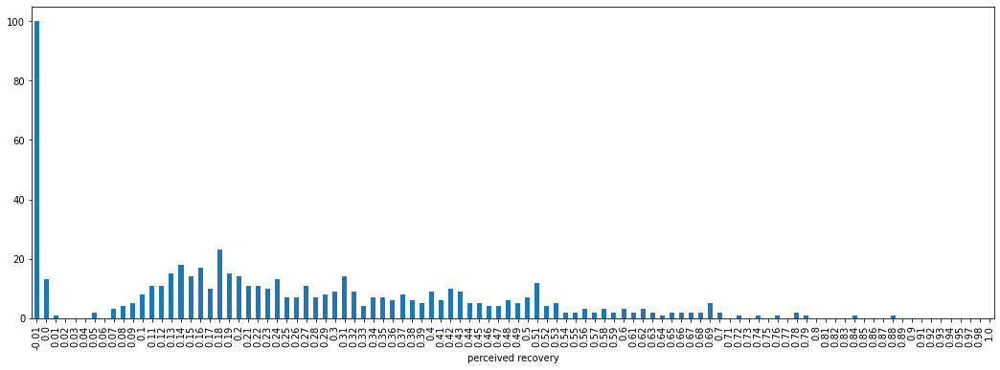

In [62]:
# Compare to target column (injury)
recovery_inj= running_df.groupby('perceived recovery').sum()['injury']


#graph
plt.figure(figsize=[18,6])
recovery_inj.plot(kind= 'bar')
plt.show()


In [63]:
recovery_inj= pd.DataFrame(data=recovery_inj)
recovery_inj

,injury
perceived recovery,
-0.01,100
0.00,13
0.01,1
0.02,0
0.03,0
...,...
0.94,0
0.95,0
0.97,0


##### Observations from `perceived recovery`:
- again we see the -0.01 issue which will have to be addressed.
- interesting to see 0 not be the most prominent value (see histogram above) 

# Comparing Feature Distributions


Next we will compare the distributions of similar feature.

## Types of Running

<Figure size 1080x1080 with 0 Axes>

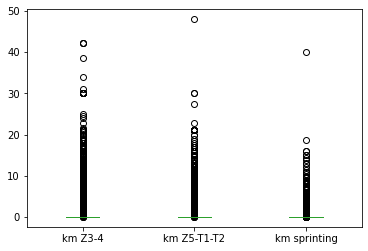

In [64]:
#creating a DF of the types of running and creating a box aplot to compare

run_type= pd.DataFrame(running_df[['km Z3-4', 'km Z5-T1-T2', 'km sprinting']])

#graph
plt.figure(figsize=(15,15))
run_type.plot(kind= 'box')
plt.show()


In [65]:
run_type.describe()

,km Z3-4,km Z5-T1-T2,km sprinting
count,42766.000000,42766.000000,42766.000000
mean,0.691381,0.579930,0.073016
std,2.317657,1.811938,0.483480
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000
max,42.200000,48.000000,40.000000


- We can see that all 3 types of runnning are skewed with 0 as their 75th percentile before spiking at their max. 
- `km Z5-T1-T2` is the intensity where athlets do most of their running, and sprinting is the where the elast mileage is accured. 

## Perceived- Recovery, Exertion & Success

<Figure size 432x288 with 0 Axes>

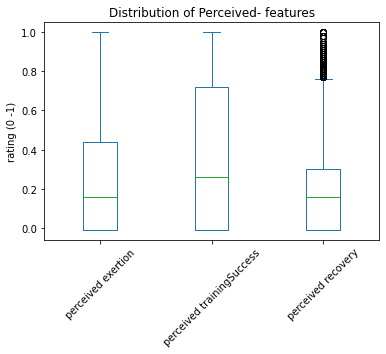

In [66]:
perceptions_df= pd.DataFrame(running_df[['perceived exertion', 'perceived trainingSuccess', 'perceived recovery']])

#graph
plt.figure()
perceptions_df.plot(kind= 'box')
plt.xticks(rotation=45)
plt.title('Distribution of Perceived- features')
plt.ylabel('rating (0 -1)')
plt.show()

In [67]:
perceptions_df.describe()

,perceived exertion,perceived trainingSuccess,perceived recovery
count,42766.000000,42766.000000,42766.000000
mean,0.247788,0.349802,0.195898
std,0.257262,0.368300,0.190321
min,-0.010000,-0.010000,-0.010000
25%,-0.010000,-0.010000,-0.010000
50%,0.160000,0.260000,0.160000
75%,0.440000,0.720000,0.300000
max,1.000000,1.000000,1.000000


#### Observation of Comparison of Perceived- columns
- mean perception of exertion and success, is higher than recovery, which we would assume would be conencted to more injuruies but is not shown in our data
- *NOTE*: we can again see that the min in all columns is -0.01, which doesnt align with the supposed 0-1 scale. Will investigate this further.

## Investigating -0.01 in Percived- columns
During our invertigation into the data we found that the largest portion (26%) of inputs in all of the `Percieved-__` columns was consistantly `-0.01`. This how ever did not make sense as even the notes from the original study stated that these columns should only range 0-1. 
We will confirm that this is apparent in all features within a category (i.e. accross all columns in perceived exertion), and compare rows that have a `-0.01` to rows with `0` to see if there are similar trends and this was simply a mistake.  

Will see if this is occuring in all columns of the category.

In [68]:
#creating display of all percived exertions to see if it is common accross all columns of this category.
perceived_exertions = running_df[['perceived exertion', 'perceived exertion.1', 'perceived exertion.2', 'perceived exertion.3', 'perceived exertion.4', 'perceived exertion.5', 'perceived exertion.6']]

pe_df=pd.DataFrame(perceived_exertions)

In [69]:
pe_df

,perceived exertion,perceived exertion.1,perceived exertion.2,perceived exertion.3,perceived exertion.4,perceived exertion.5,perceived exertion.6
0,0.11,-0.01,0.10,-0.01,0.08,0.11,0.10
1,-0.01,0.10,-0.01,0.08,0.11,0.10,0.10
2,0.10,-0.01,0.08,0.11,0.10,0.10,-0.01
3,-0.01,0.08,0.11,0.10,0.10,-0.01,0.10
4,0.08,0.11,0.10,0.10,-0.01,0.10,0.11
...,...,...,...,...,...,...,...
42761,0.54,-0.01,0.91,0.08,-0.01,0.15,-0.01
42762,-0.01,-0.01,-0.01,-0.01,0.45,-0.01,-0.01
42763,0.94,-0.01,-0.01,0.85,-0.01,0.44,-0.01
42764,0.87,-0.01,0.49,0.73,-0.01,0.35,0.79


Can confirm that this -0.01 issue is happening accross entire category. Next we will see if this was an error and the minimal negative value was meant to be a 0, by comparing dataframes with those values in place of the percived exertiuon columns. If the associated metrics are identical then we can convert the -0.01's to 0.

In [70]:
#finding all cells at least in one category (in this case percieved exertion) with the -0.01 input
exertion_investigation_df= running_df[running_df['perceived exertion.6'] == -0.01]

exertion_0_df=running_df[running_df['perceived exertion.6'] == 0]


In [71]:
#creating dataframes to compare
ei_df= exertion_investigation_df.iloc[: , [60,61,62,63,64,65,66,67,68,69,70,71, 72]]
exertion_0_df=exertion_0_df.iloc[: , [60,61,62,63,64,65,66,67,68,69,70,71, 72]]

In [72]:
ei_df.describe()

,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
count,11479.0,11479.0,11479.0,11479.0,11479.0,11479.0,11479.0,1.147900e+04,1.147900e+04,1.147900e+04,11479.000000,11479.000000,11479.000000
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.000000e-02,-1.000000e-02,-1.000000e-02,34.350379,0.009408,1141.436014
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.901340e-15,1.901340e-15,1.901340e-15,18.857974,0.096544,791.311256
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.000000e-02,-1.000000e-02,-1.000000e-02,0.000000,0.000000,0.000000
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.000000e-02,-1.000000e-02,-1.000000e-02,21.000000,0.000000,359.500000
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.000000e-02,-1.000000e-02,-1.000000e-02,34.000000,0.000000,1099.000000
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.000000e-02,-1.000000e-02,-1.000000e-02,47.000000,0.000000,1785.000000
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.000000e-02,-1.000000e-02,-1.000000e-02,73.000000,1.000000,2665.000000


In [73]:
exertion_0_df.describe()

,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
count,1050.00000,1050.000000,1050.000000,1050.000000,1050.000000,1050.000000,1050.000000,1050.0,1050.000000,1050.000000,1050.000000,1050.000000,1050.000000
mean,1.06381,9.933143,1.003905,0.273048,0.011524,0.149524,0.055286,0.0,0.281238,0.048886,33.561905,0.009524,1074.823810
std,0.24453,6.363539,2.547990,1.384948,0.113151,0.372461,0.289069,0.0,0.413540,0.120402,13.633165,0.097170,265.636076
min,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,1.000000,0.000000,10.000000
25%,1.00000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,20.500000,0.000000,871.000000
50%,1.00000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,37.000000,0.000000,1069.500000
75%,1.00000,13.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.770000,0.000000,41.000000,0.000000,1281.000000
max,2.00000,49.200000,21.100000,17.000000,2.000000,2.000000,3.830000,0.0,1.000000,0.930000,71.000000,1.000000,2363.000000


In [74]:
running_df.describe()

,nr. sessions,total km,km Z3-4,km Z5-T1-T2,km sprinting,strength training,hours alternative,perceived exertion,perceived trainingSuccess,perceived recovery,nr. sessions.1,total km.1,km Z3-4.1,km Z5-T1-T2.1,km sprinting.1,strength training.1,hours alternative.1,perceived exertion.1,perceived trainingSuccess.1,perceived recovery.1,nr. sessions.2,total km.2,km Z3-4.2,km Z5-T1-T2.2,km sprinting.2,strength training.2,hours alternative.2,perceived exertion.2,perceived trainingSuccess.2,perceived recovery.2,nr. sessions.3,total km.3,km Z3-4.3,km Z5-T1-T2.3,km sprinting.3,strength training.3,hours alternative.3,perceived exertion.3,perceived trainingSuccess.3,perceived recovery.3,nr. sessions.4,total km.4,km Z3-4.4,km Z5-T1-T2.4,km sprinting.4,strength training.4,hours alternative.4,perceived exertion.4,perceived trainingSuccess.4,perceived recovery.4,nr. sessions.5,total km.5,km Z3-4.5,km Z5-T1-T2.5,km sprinting.5,strength training.5,hours alternative.5,perceived exertion.5,perceived trainingSuccess.5,perceived recovery.5,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
count,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000,42766.000000
mean,0.829561,7.038187,0.691381,0.579930,0.073016,0.116237,0.163492,0.247788,0.349802,0.195898,0.829000,7.024199,0.689436,0.574926,0.072614,0.117126,0.164331,0.247228,0.349327,0.195780,0.829561,7.039143,0.695195,0.578438,0.073135,0.116518,0.163359,0.247726,0.349382,0.196104,0.829280,7.039936,0.692611,0.578181,0.072693,0.116307,0.162977,0.247664,0.349609,0.196164,0.829865,7.042934,0.695447,0.577788,0.072167,0.116214,0.162675,0.247642,0.349797,0.196250,0.828766,7.054684,0.697388,0.580073,0.072303,0.115886,0.161330,0.247697,0.349669,0.196298,0.828813,7.051319,0.695031,0.580347,0.072595,0.116120,0.162308,0.247550,0.349503,0.196224,34.550858,0.013632,1228.039892
std,0.580696,7.473216,2.317657,1.811938,0.483480,0.326010,0.549664,0.257262,0.368300,0.190321,0.581215,7.473041,2.310966,1.805558,0.484186,0.327197,0.552471,0.256781,0.368236,0.190313,0.580736,7.470759,2.328649,1.808320,0.485633,0.326699,0.550724,0.257149,0.368063,0.190505,0.580533,7.464805,2.315000,1.810760,0.481981,0.326380,0.548887,0.257077,0.368157,0.190568,0.580321,7.461837,2.324751,1.807505,0.479745,0.326270,0.546884,0.256785,0.368123,0.190499,0.579696,7.470514,2.327571,1.811543,0.487074,0.325741,0.544333,0.256950,0.368109,0.190694,0.579951,7.470174,2.323844,1.814538,0.483691,0.326016,0.554031,0.256718,0.368042,0.190568,19.050033,0.115960,807.021168
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.010000,-0.010000,0.000000,0.000000

We can see that when just the percieved exertion (let alone the other perception columns) is -0.01, 
- the athletes are not running or even exercising (strength/ alternative) at all, seeing as all values for these columns are exclusively 0. 
- we can also see that percieved success and -recovery area also consistantly -0.01 as well
- however this is this is not exclusively atheltes with injury (seen in injury max)


Due to the high similarity and lack of alternative explanation we will change these values to 0.

## Replacing -0.01 with 0

In [75]:
#MAKING DUPLICATE OF MY DF to apply changes to
running_df_cleaned=running_df

In [77]:
# make list of columns that need to be changed (i.e. all exertion, recovery and training success columns)
percieved_columns= ['perceived exertion', 'perceived exertion.1', 'perceived exertion.2', 'perceived exertion.3',\
                    'perceived exertion.4', 'perceived exertion.5', 'perceived exertion.6', 'perceived recovery', \
                    'perceived recovery.1', 'perceived recovery.2', 'perceived recovery.3', 'perceived recovery.4',\
                    'perceived recovery.5', 'perceived recovery.6', 'perceived trainingSuccess', 'perceived trainingSuccess.1',\
                    'perceived trainingSuccess.2', 'perceived trainingSuccess.3', 'perceived trainingSuccess.4',\
                    'perceived trainingSuccess.5', 'perceived trainingSuccess.6'
]

#CREATING A LOOP to replace -0.01 in each column
for col_name in percieved_columns:
    running_df_cleaned[col_name]= running_df_cleaned[col_name].replace(-0.01, 0)


In [78]:
#SANITY CHECK
running_df_cleaned.head()

,nr. sessions,total km,km Z3-4,km Z5-T1-T2,km sprinting,strength training,hours alternative,perceived exertion,perceived trainingSuccess,perceived recovery,nr. sessions.1,total km.1,km Z3-4.1,km Z5-T1-T2.1,km sprinting.1,strength training.1,hours alternative.1,perceived exertion.1,perceived trainingSuccess.1,perceived recovery.1,nr. sessions.2,total km.2,km Z3-4.2,km Z5-T1-T2.2,km sprinting.2,strength training.2,hours alternative.2,perceived exertion.2,perceived trainingSuccess.2,perceived recovery.2,nr. sessions.3,total km.3,km Z3-4.3,km Z5-T1-T2.3,km sprinting.3,strength training.3,hours alternative.3,perceived exertion.3,perceived trainingSuccess.3,perceived recovery.3,nr. sessions.4,total km.4,km Z3-4.4,km Z5-T1-T2.4,km sprinting.4,strength training.4,hours alternative.4,perceived exertion.4,perceived trainingSuccess.4,perceived recovery.4,nr. sessions.5,total km.5,km Z3-4.5,km Z5-T1-T2.5,km sprinting.5,strength training.5,hours alternative.5,perceived exertion.5,perceived trainingSuccess.5,perceived recovery.5,nr. sessions.6,total km.6,km Z3-4.6,km Z5-T1-T2.6,km sprinting.6,strength training.6,hours alternative.6,perceived exertion.6,perceived trainingSuccess.6,perceived recovery.6,Athlete ID,injury,Date
0,1.0,5.8,0.0,0.6,1.2,0.0,0.00,0.11,0.0,0.18,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.0,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.0,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.0,0.11,0.0,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.10,0.0,0.15,0,0,0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.0,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.0,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.0,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.10,0.0,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.0,0.10,0.0,0.17,0,0,1
2,1.0,0.0,0.0,0.0,0.0,1.0,0.00,0.10,0.0,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.0,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.0,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.0,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.0,0.10,0.0,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0,0,2
3,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.0,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.0,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.0,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.00,0.10,0.0,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.10,0.0,0.17,0,0,3
4,1.0,0.0,0.0,0.0,0.0,0.0,1.08,0.08,0.0,0.18,1.0,16.4,10.0,0.0,0.0,1.0,0.00,0.11,0.0,0.17,1.0,0.0,0.0,0.0,0.0,0.0,1.00,0.10,0.0,0.15,1.0,5.2,0.0,0.5,1.2,0.0,0.00,0.10,0.0,0.17,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.10,0.0,0.17,1.0,17.6,7.2,0.0,0.0,0.0,0.0,0.11,0.0,0.17,0,0,4


In [ ]:
# exporting a copy of this data to be used in our models

running_df_cleaned.to_csv('running_df_cleaned.csv')


In [ ]:
# exporting a copy of this data to be used in our models

running_df_cleaned.to_csv('running_df_cleaned2.csv', index=None)


##  Dropping extra columns?

Tempted to drop the other columns seeing as they are so similar, but then we would only see the influce of activity day of. at least with these repeating columns way we can see the effect of particular training days relative to the final day of injury, (i.e. if a high number of totl kms 4 days prior correlates with injury, we will see that in the correlation between `total km.1` and `injury`).

## Conclusion
OUr data has been checked for nulls and duplicates, has had each feature inspected, and has had residual issues corrected. Now we can begin testing models to predict injury; this will be done on the attached notebook (`LOG REG`).

To return to top:[Exploratory Data Analysis](#Exploratory-Data-Analysis)